<a href="https://colab.research.google.com/github/Nosa10/OIBSIP/blob/main/EDA_NYC_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import seaborn as sns
import geopandas as gpd
import warnings
warnings.filterwarnings("ignore")

nyc_df = pd.read_csv('/content/AB_NYC_2019.csv')
nyc_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
nyc_df.shape

(48895, 16)

In [ ]:
nyc_df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [ ]:
nyc_df.isna().sum()

,0
id,0
name,16
host_id,0
host_name,21
neighbourhood_group,0
neighbourhood,0
latitude,0
longitude,0
room_type,0
price,0


In [ ]:
missing_hosts = nyc_df[nyc_df['host_name'].isna()]
print(missing_hosts[['host_id','host_name','neighbourhood_group', 'neighbourhood']])


         host_id host_name neighbourhood_group     neighbourhood
360       526653       NaN              Queens    Queens Village
2700     7779204       NaN            Brooklyn          Flatbush
5745      919218       NaN           Manhattan            Harlem
6075    23077718       NaN            Brooklyn     Crown Heights
6582    24576978       NaN            Brooklyn        Greenpoint
8163    32722063       NaN            Brooklyn     East Flatbush
8257    33134899       NaN            Brooklyn          Bushwick
8852    32722063       NaN            Brooklyn     East Flatbush
9138     5162530       NaN            Brooklyn      Williamsburg
9817    39608626       NaN           Manhattan            Harlem
14040    7822683       NaN            Brooklyn        Greenpoint
14631   26138712       NaN              Queens  Ditmars Steinway
15174    5300585       NaN           Manhattan           Chelsea
19565  100971588       NaN               Bronx        Highbridge
27777     415290       Na

Instead of dropping the rows having missing names and host names columns we can use a default name since the host id can cover that

In [ ]:
nyc_df['name'].fillna('No name provided', inplace=True)
nyc_df['host_name'].fillna('Unknown host', inplace=True)


In [ ]:
nyc_df.isna().sum()

,0
id,0
name,0
host_id,0
host_name,0
neighbourhood_group,0
neighbourhood,0
latitude,0
longitude,0
room_type,0
price,0


In [ ]:
missing_dates = nyc_df[nyc_df['last_review'].isna()]
print(missing_dates['number_of_reviews'])


2        0
19       0
26       0
36       0
38       0
        ..
48890    0
48891    0
48892    0
48893    0
48894    0
Name: number_of_reviews, Length: 10052, dtype: int64


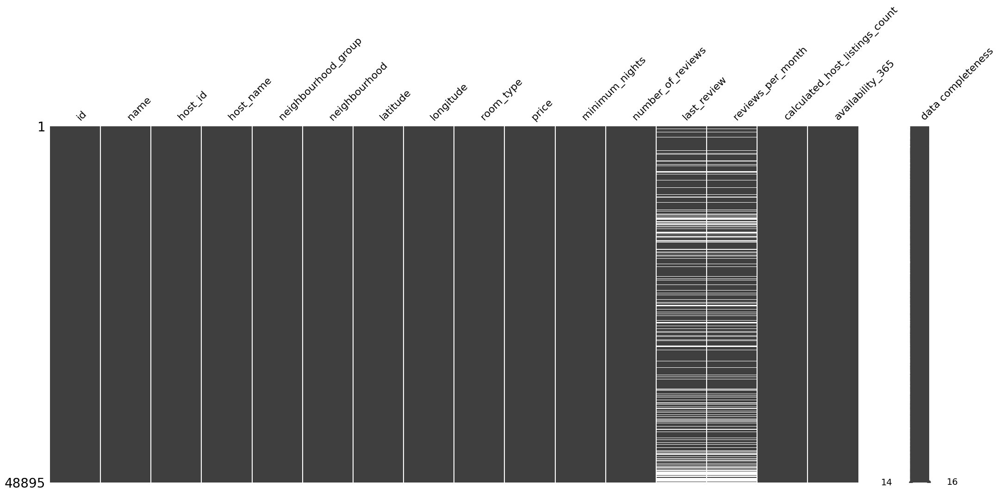

In [ ]:
msno.matrix(nyc_df, figsize=(25, 10),
    width_ratios=(15, 1),
    color=(0.25, 0.25, 0.25),
    fontsize=16,
    labels="Missing Values",
    label_rotation=45)
plt.show()

In [ ]:
nyc_df.dropna(inplace=True)
nyc_df.isna().sum()

,0
id,0
name,0
host_id,0
host_name,0
neighbourhood_group,0
neighbourhood,0
latitude,0
longitude,0
room_type,0
price,0


In [ ]:
duplicate_rows=nyc_df.duplicated().sum()
print(f"Number Of Duplicate Rows : {duplicate_rows}")

Number Of Duplicate Rows : 0


In [ ]:
nyc_df.shape

(38843, 16)

In [ ]:
nyc_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129


Neighbourhood_group population

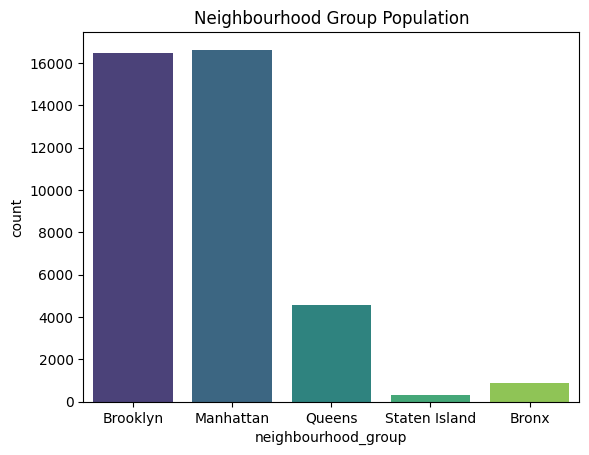

In [ ]:
sns.countplot(x='neighbourhood_group', data=nyc_df, palette='viridis')
plt.title('Neighbourhood Group Population')
plt.show()


          neighbourhood  count
212        Williamsburg   3163
13   Bedford-Stuyvesant   3141
93               Harlem   2206
28             Bushwick   1944
94       Hell's Kitchen   1532
..                  ...    ...
32          Castle Hill      2
206          West Farms      2
163        Richmondtown      1
170           Rossville      1
213         Willowbrook      1

[218 rows x 2 columns]


Text(0.5, 1.0, 'Top 10 Neighbourhoods by Population Count')

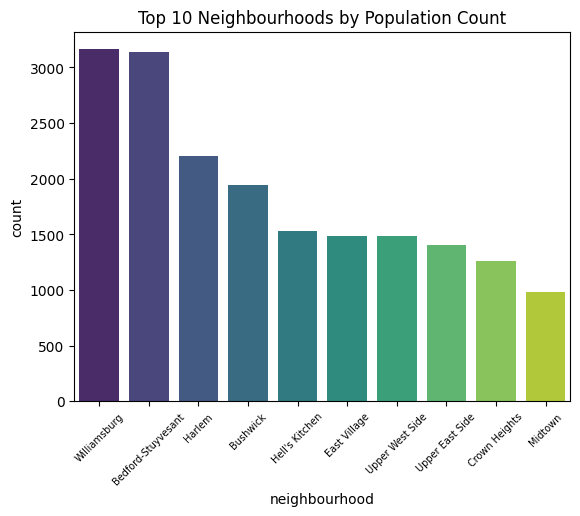

In [ ]:
top_10_neighbourhoods = nyc_df.groupby('neighbourhood')['neighbourhood'].count().reset_index(name='count').sort_values(['count'], ascending=False)
print(top_10_neighbourhoods)
ax = sns.barplot(data=top_10_neighbourhoods.head(10),x='neighbourhood',y='count',palette='viridis')
ax.set_xticklabels(ax.get_xticklabels(),rotation=45,fontsize=7)
ax.set_title('Top 10 Neighbourhoods by Population Count')

In [ ]:
!pip install mapclassify folium matplotlib
gpd.GeoDataFrame(
    nyc_df,geometry=gpd.points_from_xy(nyc_df["longitude"],nyc_df["latitude"]),crs="epsg:4386"
).explore(width=1000,height=600,name="correct")

Room Types

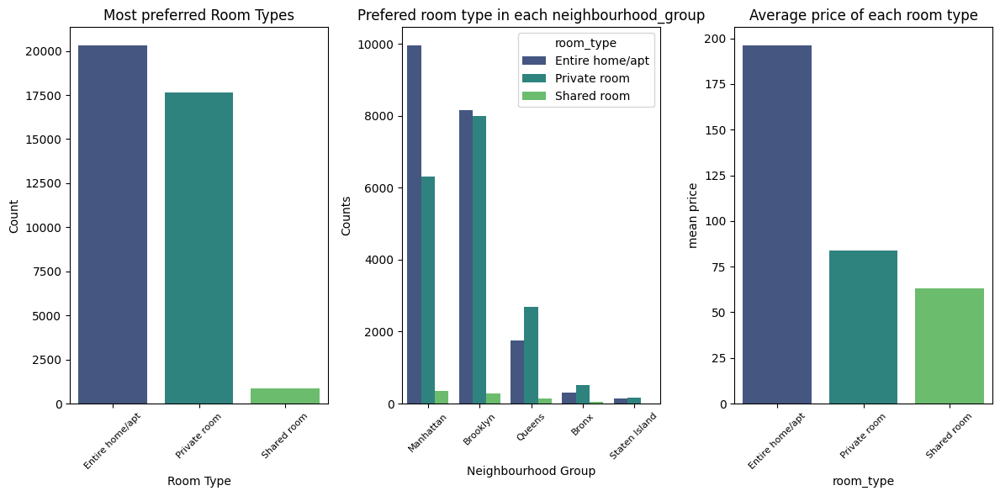

In [ ]:
room_type = nyc_df.groupby('room_type')['room_type'].count().reset_index(name='count').sort_values('count',ascending=False)
room_counts = nyc_df.groupby(['neighbourhood_group', 'room_type']).size().reset_index(name='count')
room_type_price = nyc_df.groupby('room_type')['price'].mean().reset_index(name='mean price').sort_values('mean price',ascending=False)
fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,6))

room_counts = room_counts.sort_values(by='count', ascending=False)
ax1 = sns.barplot(data=room_type, x='room_type', y='count', palette='viridis', ax=ax1)
ax1.set_title("Most preferred Room Types")
ax1.set_xlabel("Room Type")
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=45,fontsize=8)
ax1.set_ylabel("Count")
ax2 = sns.barplot(data=room_counts, x='neighbourhood_group', y='count', hue='room_type', palette='viridis', ax=ax2)
ax2.set_title("Prefered room type in each neighbourhood_group")
ax2.set_xlabel("Neighbourhood Group")
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=45,fontsize=8)
ax2.set_ylabel("Counts")
ax3 = sns.barplot(data=room_type_price, x='room_type', y='mean price', palette='viridis', ax=ax3)
ax3.set_title("Average price of each room type")
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=45,fontsize=8)

plt.tight_layout()
plt.show()

Despite having an higher Price, Entire homes and apartment are still the most preferred room types with prices significantly higher in Manhattan and Brooklyn, reflecting high demand in those areas

Most Expensive and Cheapest Neighboorhoods

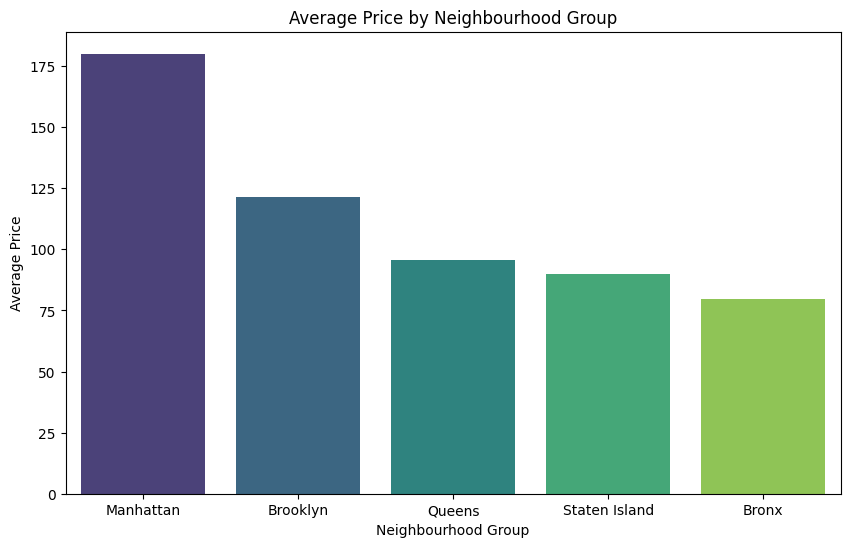

In [ ]:
avg_price_by_neighbourhood_group = nyc_df.groupby('neighbourhood_group')['price'].mean().reset_index(name='mean price').sort_values('mean price',ascending=False)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(data=avg_price_by_neighbourhood_group, x='neighbourhood_group', y='mean price', palette='viridis', ax=ax)
plt.title("Average Price by Neighbourhood Group")
plt.xlabel("Neighbourhood Group")
plt.ylabel("Average Price")
plt.show()

Let's check the median Price for the neighbourhood_group

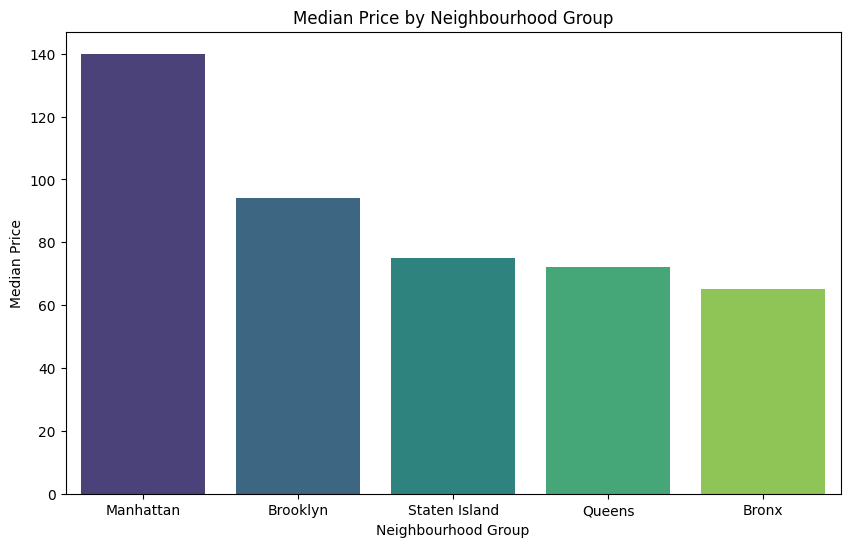

In [ ]:
avg_price_by_neighbourhood_group = nyc_df.groupby('neighbourhood_group')['price'].median().reset_index(name='mean price').sort_values('mean price',ascending=False)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(data=avg_price_by_neighbourhood_group, x='neighbourhood_group', y='mean price', palette='viridis', ax=ax)
plt.title("Median Price by Neighbourhood Group")
plt.xlabel("Neighbourhood Group")
plt.ylabel("Median Price")
plt.show()

The Price is significantly lower than the mean price, which may indicate the presence of outliers

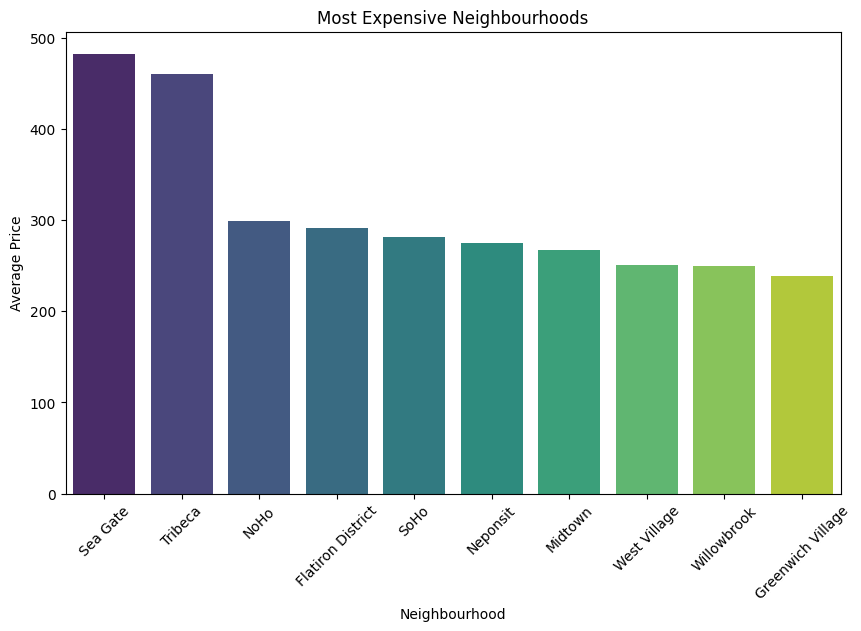

In [ ]:
most_expensive_neighbourhoods = nyc_df.groupby('neighbourhood')['price'].mean().reset_index(name='mean price').sort_values('mean price',ascending=False)
most_expensive_neighbourhoods = most_expensive_neighbourhoods.head(10)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(data=most_expensive_neighbourhoods, x='neighbourhood', y='mean price', palette='viridis', ax=ax)
plt.title("Most Expensive Neighbourhoods")
plt.xticks(rotation=45)
plt.xlabel("Neighbourhood")
plt.ylabel("Average Price")
plt.show()

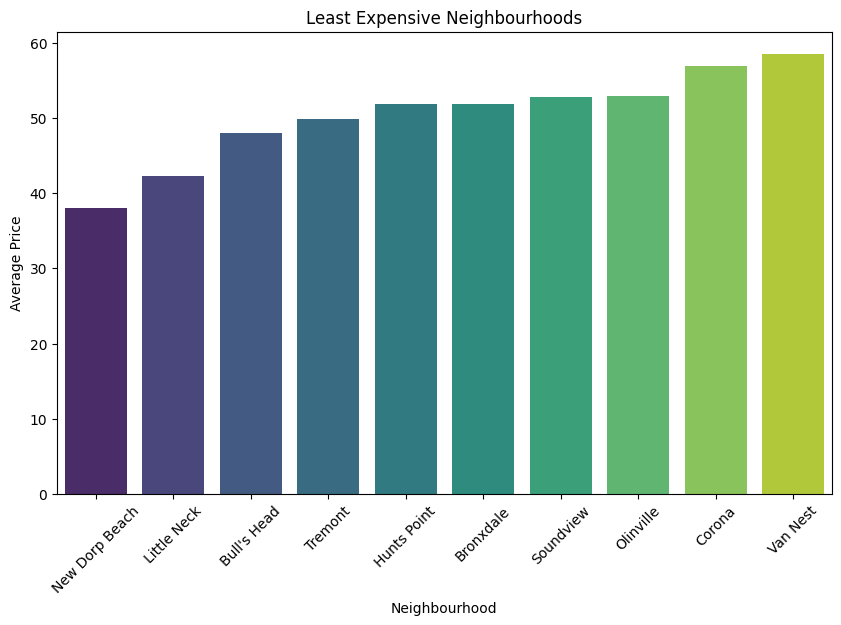

In [ ]:
least_expensive_neighbourhoods = nyc_df.groupby('neighbourhood')['price'].mean().reset_index(name='mean price').sort_values('mean price',ascending=True)
least_expensive_neighbourhoods = least_expensive_neighbourhoods.head(10)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(data=least_expensive_neighbourhoods, x='neighbourhood', y='mean price', palette='viridis', ax=ax)
plt.title("Least Expensive Neighbourhoods")
plt.xticks(rotation=45)
plt.xlabel("Neighbourhood")
plt.ylabel("Average Price")
plt.show()

In [ ]:
#Let's use a box plot to check for outliers

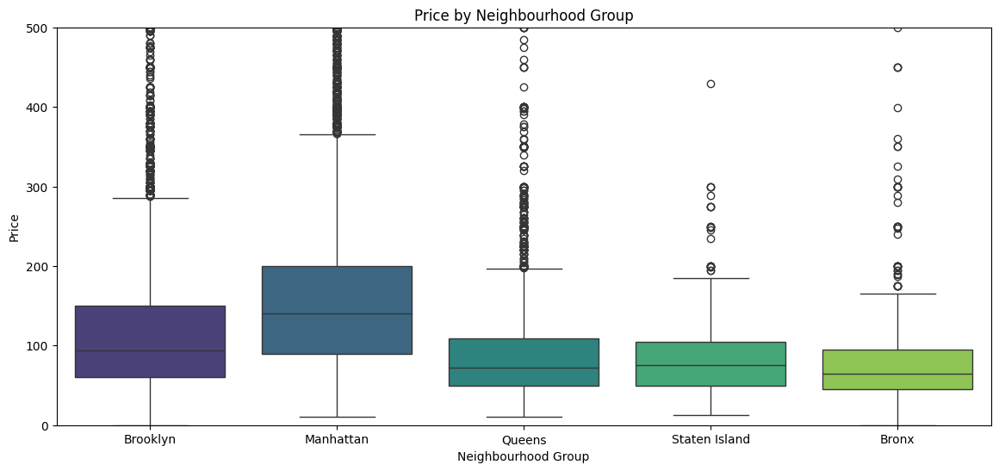

In [ ]:
plt.figure(figsize=(14, 6))
sns.boxplot(x='neighbourhood_group', y='price', data=nyc_df,palette='viridis')
plt.title("Price by Neighbourhood Group")
plt.xlabel("Neighbourhood Group")
plt.ylabel("Price")
plt.ylim(0, 500)
plt.show()



*   Manhattan is the most expensive borough in New York. It is so expensive, that it drives the average apartment price in the city to be higher than those in the remaining four boroughs.
*   There is a huge difference in price between the most and least expensive neighbourhoods.


*   The median price is significantly lower than the average price, which means that we expect to find many outliers in the price column.
*   The last plot at the bottom is the confirmation of the previous statements. The apartment prices in Brooklyn, Manhattan and Queens show the presence of outliers.





Minimum Nights

Minimum nights is a good indicator.  A high number means that the property is used for a long time, which is a good sign from a customer point of view.

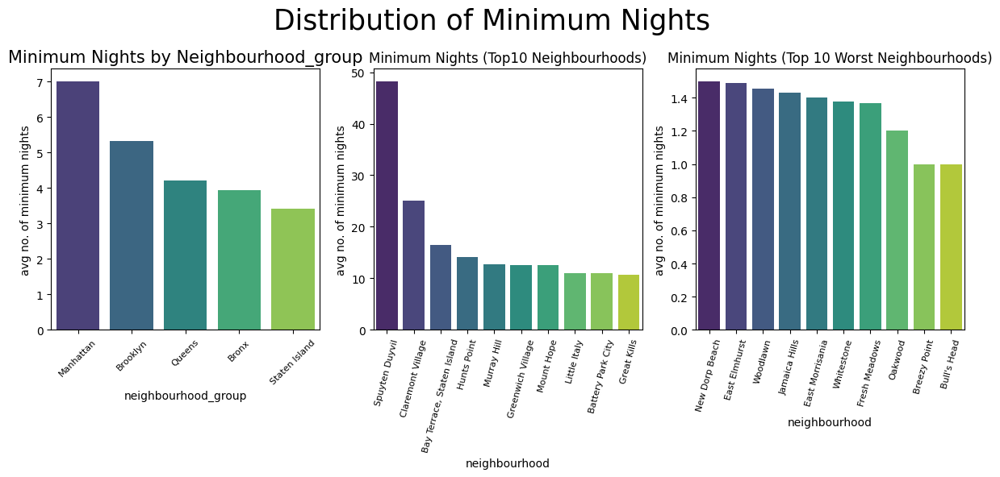

In [ ]:
minimum_nights_neighbourhood_group = nyc_df.groupby('neighbourhood_group')['minimum_nights'].mean().reset_index(name='avg no. of minimum nights').sort_values('avg no. of minimum nights',ascending=False)


minimum_nights_neighbourhood = nyc_df.groupby('neighbourhood')['minimum_nights'].mean().reset_index(name='avg no. of minimum nights').sort_values('avg no. of minimum nights',ascending=False)
fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,6))

ax1 = sns.barplot(data=minimum_nights_neighbourhood_group,x='neighbourhood_group',y='avg no. of minimum nights',palette='viridis',ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=45,fontsize=8)
ax1.set_title('Minimum Nights by Neighbourhood_group',size=15)

ax2 = sns.barplot(data=minimum_nights_neighbourhood.head(10),x='neighbourhood',y='avg no. of minimum nights',palette='viridis',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=75,fontsize=8)
ax2.set_title('Minimum Nights (Top10 Neighbourhoods)',size=12)

ax3 = sns.barplot(data=minimum_nights_neighbourhood.tail(10),x='neighbourhood',y='avg no. of minimum nights',palette='viridis',ax=ax3)
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=75,fontsize=8)
ax3.set_title('Minimum Nights (Top 10 Worst Neighbourhoods)',size=12)

plt.suptitle('Distribution of Minimum Nights',size=25)

plt.tight_layout()

Visitors spend the most nights in Manhattan. This means that they really enjoy their time there.

Let's investigate the neighbourhoods with the highest minimum nights, some of the numbers are very high, maybe there are outliers. It is worth to check whether these places had many guests or only a couple of them who spent a lot of nights there.

In [ ]:
data = nyc_df.loc[nyc_df['neighbourhood']=='Spuyten Duyvil']
data

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
966,385824,New York City- Riverdale Modern two bedrooms unit,1931205,Orit,Bronx,Spuyten Duyvil,40.87991,-73.91673,Entire home/apt,120,2,47,2019-07-03,1.22,1,318
14579,11497938,One Bedroom with kids room / office,60501531,John,Bronx,Spuyten Duyvil,40.88058,-73.91812,Entire home/apt,79,186,7,2016-07-30,0.18,1,365
30602,23669006,"4 bdrm Riverdale apt, 15-30 minutes to Manhattan",2965556,Mj,Bronx,Spuyten Duyvil,40.88316,-73.91151,Entire home/apt,360,2,8,2019-06-16,0.51,1,71
37681,29876453,"In Riverdale, a most unusual apartment to enjoy.",124867390,Karel,Bronx,Spuyten Duyvil,40.88071,-73.92074,Private room,60,3,8,2019-06-16,1.11,1,326


There are just 4 visits to the neighbourhood but one of them spent a very high 186 nights there which accounts for the high average

Let's Investigate Claremont Village

In [ ]:
data = nyc_df.loc[nyc_df['neighbourhood']=='Claremont Village']
data

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
4140,2669366,"Priv. Room in a House,15min,Manhatt",13664245,Denise,Bronx,Claremont Village,40.84192,-73.91108,Private room,40,3,46,2019-05-31,0.72,2,292
16298,13117282,Cheerful & Practical Garden Apartment Near Subway,2988712,Sasha,Bronx,Claremont Village,40.83458,-73.91021,Entire home/apt,57,90,11,2019-05-10,0.31,7,68
16824,13417723,"Big 4 Bedroom Apartment near Subway, All Renov...",2988712,Sasha,Bronx,Claremont Village,40.83570,-73.91023,Entire home/apt,110,90,11,2018-08-23,0.30,7,77
18327,14375153,Call it Home.,75506967,Mimie,Bronx,Claremont Village,40.83796,-73.90160,Private room,38,15,8,2018-08-02,0.23,2,24
24232,19527492,"Huge Apartment Near Subway, Quiet and Sunny!",2988712,Sasha,Bronx,Claremont Village,40.83625,-73.91079,Entire home/apt,127,90,4,2018-12-12,0.19,7,250
24516,19718634,Enormous apartment with everything you need,3495471,Russell,Bronx,Claremont Village,40.83561,-73.91108,Entire home/apt,58,3,59,2019-06-03,2.89,1,42
24759,19877706,Big 3 Bedroom Garden Level Apartment Near Subway,2988712,Sasha,Bronx,Claremont Village,40.83507,-73.91040,Entire home/apt,72,90,2,2018-04-23,0.12,7,223
25540,20437233,Comfy room with great bed and private bathroom,1939209,Farrel,Bronx,Claremont Village,40.83556,-73.91098,Private room,70,4,42,2019-05-28,1.85,2,77
26122,20830442,Cozy room in lovely apartment close to subway,1939209,Farrel,Bronx,Claremont Village,40.83500,-73.91114,Private room,60,4,30,2019-07-07,1.38,2,179
32797,25833266,Huge private & cozy room in the Bronx!,194102474,Digna,Bronx,Claremont Village,40.84346,-73.91151,Private room,35,1,49,2019-01-23,3.84,1,168


This is different as there are a high number of guests and the price is relatively low,so people may spend more time there.

I am plotting the average number of minimum nights by neighbourhood again this time excluding those places where the number of Airbnb apartments is lower than 20.

In [ ]:
neighbourhood_counts = nyc_df['neighbourhood'].value_counts()
neighbourhood_list = neighbourhood_counts[neighbourhood_counts > 20].index
print(neighbourhood_list)
filtered_nyc_df = nyc_df.loc[nyc_df['neighbourhood'].isin(neighbourhood_list)]

Index(['Williamsburg', 'Bedford-Stuyvesant', 'Harlem', 'Bushwick',
       'Hell's Kitchen', 'East Village', 'Upper West Side', 'Upper East Side',
       'Crown Heights', 'Midtown',
       ...
       'Norwood', 'DUMBO', 'Stapleton', 'Concord', 'Highbridge',
       'Stuyvesant Town', 'Kew Gardens', 'Far Rockaway', 'Kew Gardens Hills',
       'Throgs Neck'],
      dtype='object', name='neighbourhood', length=122)


        neighbourhood  avg no. of minimum nights
76        Murray Hill                  12.704180
54  Greenwich Village                  12.628664
66       Little Italy                  11.032967
3   Battery Park City                  10.944444
65           Kips Bay                  10.655786
..                ...                        ...
87     Queens Village                   1.660000
1             Arverne                   1.651515
60            Jamaica                   1.640625
32      East Elmhurst                   1.491228
48      Fresh Meadows                   1.366667

[122 rows x 2 columns]


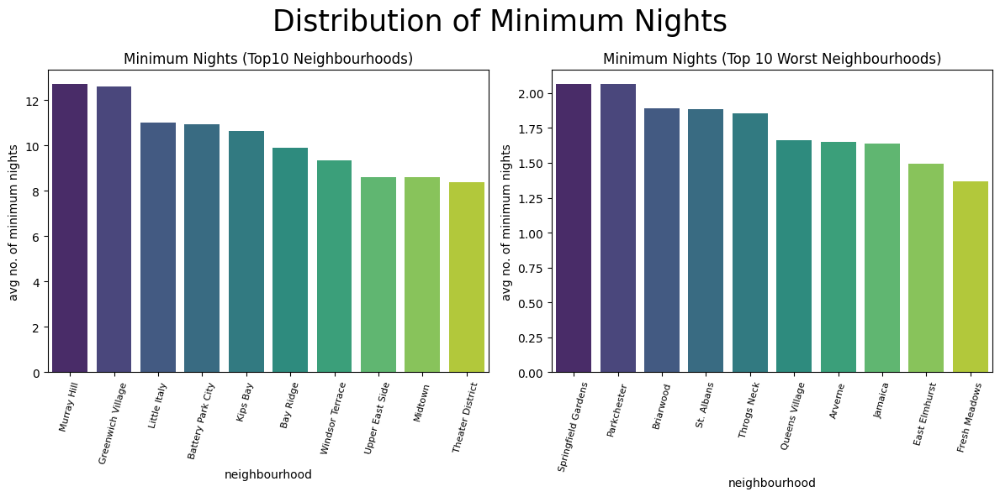

In [ ]:

minimum_nights_neighbourhood2 = filtered_nyc_df.groupby('neighbourhood')['minimum_nights'].mean().reset_index(name='avg no. of minimum nights').sort_values('avg no. of minimum nights',ascending=False)
print(minimum_nights_neighbourhood2)
fig,(ax2,ax3) = plt.subplots(ncols=2,figsize=(12,6))


ax2 = sns.barplot(data=minimum_nights_neighbourhood2.head(10),x='neighbourhood',y='avg no. of minimum nights',palette='viridis',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=75,fontsize=8)
ax2.set_title('Minimum Nights (Top10 Neighbourhoods)',size=12)

ax3 = sns.barplot(data=minimum_nights_neighbourhood2.tail(10),x='neighbourhood',y='avg no. of minimum nights',palette='viridis',ax=ax3)
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=75,fontsize=8)
ax3.set_title('Minimum Nights (Top 10 Worst Neighbourhoods)',size=12)

plt.suptitle('Distribution of Minimum Nights',size=25)

plt.tight_layout()

The distributions are different when we exclude outliers

Availability

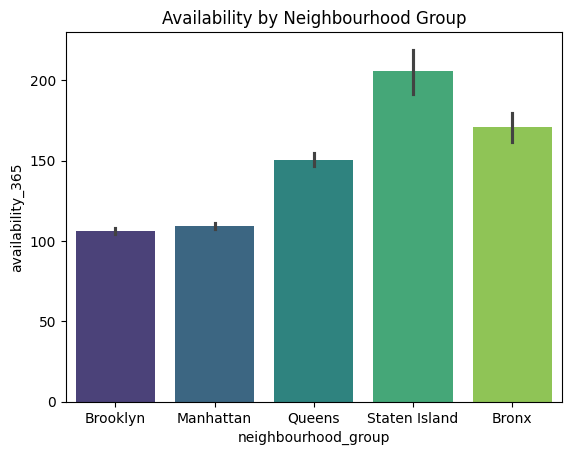

In [ ]:
sns.barplot(x='neighbourhood_group',y='availability_365',data=nyc_df,palette='viridis')
plt.title('Availability by Neighbourhood Group')
plt.show()

State Island apartments are usually the most available throughout the year

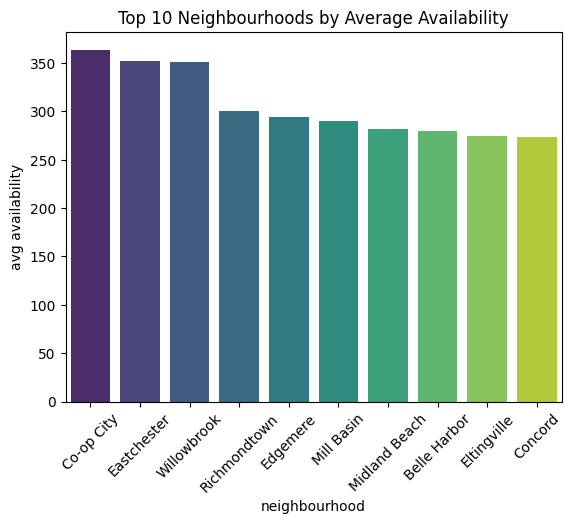

In [ ]:
#Top 10 most Available Neighbourhoods
top_10_neighbourhoods = nyc_df.groupby('neighbourhood')['availability_365'].mean().reset_index(name='avg availability').sort_values('avg availability',ascending=False)
sns.barplot(data=top_10_neighbourhoods.head(10),x='neighbourhood',y='avg availability',palette='viridis')
plt.xticks(rotation=45)
plt.title('Top 10 Neighbourhoods by Average Availability')
plt.show()

Text(0.5, 1.0, 'Least 10 Neighbourhoods by Average Availability')

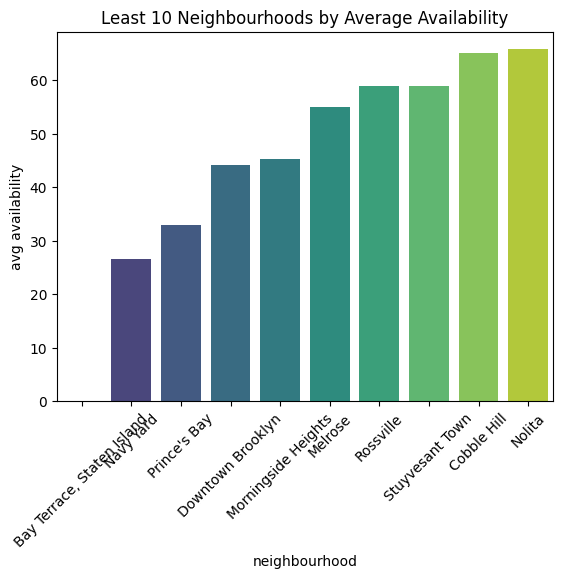

In [ ]:
#Least Available Neighbourhoods
least_available_neighbourhoods = nyc_df.groupby('neighbourhood')['availability_365'].mean().reset_index(name='avg availability').sort_values('avg availability',ascending=True)
sns.barplot(data=least_available_neighbourhoods.head(10),x='neighbourhood',y='avg availability',palette='viridis')
plt.xticks(rotation=45)
plt.title('Least 10 Neighbourhoods by Average Availability')

**Reviews**

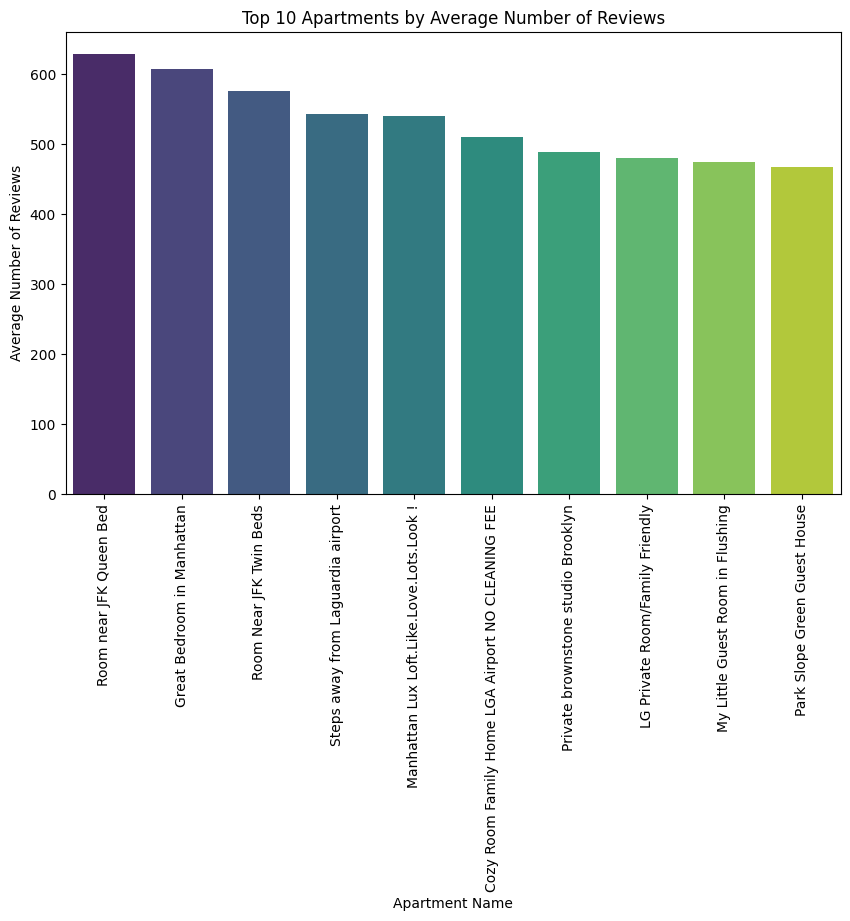

In [ ]:
# Apartment by Reviews
apartment_reviews = nyc_df.groupby('name')['number_of_reviews'].mean().reset_index(name='avg no. of reviews').sort_values('avg no. of reviews',ascending=False).head(10)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(data=apartment_reviews, x='name', y='avg no. of reviews', palette='viridis', ax=ax)
plt.title("Top 10 Apartments by Average Number of Reviews")
plt.xticks(rotation=90)
plt.xlabel("Apartment Name")
plt.ylabel("Average Number of Reviews")
plt.show()


In [ ]:
# Let's check by number of reviews per neighbourhood and neighbourhood group

reviews_per_neighbourhood_group = nyc_df.groupby('neighbourhood_group')['number_of_reviews'].sum().reset_index(name='total review count')

avg_reviews_neighbourhood_group = nyc_df.groupby('neighbourhood_group')['number_of_reviews'].mean().reset_index(name='avg reviews/apartment')

reviews_per_neighbourhood_group = reviews_per_neighbourhood_group.merge(avg_reviews_neighbourhood_group,on='neighbourhood_group').sort_values('avg reviews/apartment',ascending=False)

reviews_per_neighbourhood_group

,neighbourhood_group,total review count,avg reviews/apartment
4,Staten Island,11541,36.754777
3,Queens,156950,34.313511
0,Bronx,28371,32.386986
1,Brooklyn,486574,29.584362
2,Manhattan,454569,27.330988


There is no significant difference in the average reviews  per neighbourhood_group

In [ ]:
reviews_per_neighbourhood = nyc_df.groupby('neighbourhood')['number_of_reviews'].sum().reset_index(name='total review count')

avg_reviews_neighbourhood = nyc_df.groupby('neighbourhood')['number_of_reviews'].mean().reset_index(name='avg reviews/apartment')

reviews_per_neighbourhood = reviews_per_neighbourhood.merge(avg_reviews_neighbourhood,on='neighbourhood').sort_values('total review count',ascending=False).head(10)

reviews_per_neighbourhood

,neighbourhood,total review count,avg reviews/apartment
13,Bedford-Stuyvesant,110352,35.132760
212,Williamsburg,85427,27.008220
93,Harlem,75962,34.434270
28,Bushwick,52514,27.013374
94,Hell's Kitchen,50227,32.785248
64,East Village,44670,29.979866
61,East Harlem,36446,38.608051
51,Crown Heights,36408,28.781028
200,Upper West Side,36058,24.330634
199,Upper East Side,31686,22.552313


**Host ID**

Let's check the host with the most apartments

In [ ]:
nyc_df.groupby('host_id')['host_id'].count().reset_index(name='count').sort_values('count',ascending=False).head(10)

,host_id,count
28219,219517861,207
20818,61391963,79
12016,16098958,61
25221,137358866,51
8272,7503643,49
27253,190921808,46
16117,30283594,43
2657,1475015,42
24436,120762452,40
14173,22541573,39


The first host has over 200 apartments let's check where they are located and how much they cost

In [ ]:
nyc_df.loc[nyc_df['host_id']==219517861][['neighbourhood_group','host_name']].value_counts()

,,count
neighbourhood_group,host_name,
Manhattan,Sonder (NYC),207


All their apartments are in Manhattan

In [ ]:
nyc_df.loc[nyc_df['host_id']==219517861][['price','neighbourhood_group']].groupby('neighbourhood_group').mean()

,price
neighbourhood_group,
Manhattan,270.144928


The average price is also high

Let's check the second owner

In [ ]:
nyc_df.loc[nyc_df['host_id']==61391963][['neighbourhood_group','neighbourhood','host_name']].value_counts()

neighbourhood_group  neighbourhood      host_name        
Manhattan            Kips Bay           Corporate Housing    19
                     Midtown            Corporate Housing    15
                     Upper East Side    Corporate Housing    15
                     Hell's Kitchen     Corporate Housing    14
                     Greenwich Village  Corporate Housing     4
                     Upper West Side    Corporate Housing     4
                     Little Italy       Corporate Housing     3
                     Murray Hill        Corporate Housing     3
                     Chelsea            Corporate Housing     1
                     Nolita             Corporate Housing     1
Name: count, dtype: int64

In [ ]:
nyc_df.loc[nyc_df['host_id']==61391963][['price','neighbourhood']].groupby('neighbourhood').mean()

,price
neighbourhood,
Chelsea,142.000000
Greenwich Village,156.250000
Hell's Kitchen,152.500000
Kips Bay,145.947368
Little Italy,160.666667
Midtown,143.400000
Murray Hill,150.000000
Nolita,142.000000
Upper East Side,131.666667


The prices for this host are not so high compared to the first host, they also have all their apartments at Manhattan like the first host